In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
dataset=pd.read_csv('data/IndianWeatherRepository.csv')

dataset.head()

,country,location_name,region,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,India,Ashoknagar,Madhya Pradesh,24.57,77.72,Asia/Kolkata,1693286100,2023-08-29 10:45,27.5,81.5,...,12.6,18.5,1,2,05:59 AM,06:41 PM,05:42 PM,03:38 AM,Waxing Gibbous,93
1,India,Raisen,Madhya Pradesh,23.33,77.80,Asia/Kolkata,1693286100,2023-08-29 10:45,27.5,81.5,...,10.7,14.2,1,1,06:00 AM,06:40 PM,05:39 PM,03:41 AM,Waxing Gibbous,93
2,India,Chhindwara,Madhya Pradesh,22.07,78.93,Asia/Kolkata,1693286100,2023-08-29 10:45,26.3,79.3,...,16.8,20.7,2,2,05:56 AM,06:34 PM,05:32 PM,03:39 AM,Waxing Gibbous,93
3,India,Betul,Madhya Pradesh,21.86,77.93,Asia/Kolkata,1693286100,2023-08-29 10:45,25.6,78.1,...,4.9,6.6,1,1,06:00 AM,06:38 PM,05:36 PM,03:43 AM,Waxing Gibbous,93
4,India,Hoshangabad,Madhya Pradesh,22.75,77.72,Asia/Kolkata,1693286100,2023-08-29 10:45,27.2,81.0,...,11.4,14.8,1,1,06:01 AM,06:39 PM,05:38 PM,03:42 AM,Waxing Gibbous,93


In [4]:
dataset.columns

Index(['country', 'location_name', 'region', 'latitude', 'longitude',
       'timezone', 'last_updated_epoch', 'last_updated', 'temperature_celsius',
       'temperature_fahrenheit', 'condition_text', 'wind_mph', 'wind_kph',
       'wind_degree', 'wind_direction', 'pressure_mb', 'pressure_in',
       'precip_mm', 'precip_in', 'humidity', 'cloud', 'feels_like_celsius',
       'feels_like_fahrenheit', 'visibility_km', 'visibility_miles',
       'uv_index', 'gust_mph', 'gust_kph', 'air_quality_Carbon_Monoxide',
       'air_quality_Ozone', 'air_quality_Nitrogen_dioxide',
       'air_quality_Sulphur_dioxide', 'air_quality_PM2.5', 'air_quality_PM10',
       'air_quality_us-epa-index', 'air_quality_gb-defra-index', 'sunrise',
       'sunset', 'moonrise', 'moonset', 'moon_phase', 'moon_illumination'],
      dtype='object')

In [5]:
dataset.describe()

,latitude,longitude,last_updated_epoch,temperature_celsius,temperature_fahrenheit,wind_mph,wind_kph,wind_degree,pressure_mb,pressure_in,...,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,moon_illumination
count,118847.000000,118847.000000,1.188470e+05,118847.000000,118847.000000,118847.000000,118847.000000,118847.000000,118847.000000,118847.000000,...,118847.00000,118847.000000,118847.000000,118847.000000,118847.000000,118847.000000,118847.000000,118847.000000,118847.000000,118847.000000
mean,23.099810,80.246554,1.702867e+09,20.251021,68.451995,5.003980,8.057668,157.267672,1012.876800,29.909786,...,15.80464,775.001179,43.695337,14.546392,6.657083,92.498303,109.877653,3.269918,6.640992,52.390864
std,5.791127,5.763512,5.571176e+06,6.493161,11.687504,2.794732,4.489862,115.514693,4.874726,0.143777,...,7.95439,655.421917,30.610659,15.647242,13.350623,96.368330,108.739715,1.410240,3.483063,34.875540
min,7.170000,68.970000,1.693286e+09,-30.700000,-23.300000,2.200000,3.600000,1.000000,991.000000,29.280000,...,0.00000,113.500000,0.000000,0.000000,0.000000,0.500000,0.500000,1.000000,1.000000,0.000000
25%,20.270000,76.070000,1.697921e+09,16.600000,61.800000,2.700000,4.300000,54.000000,1010.000000,29.830000,...,9.80000,413.900000,19.500000,5.200000,1.600000,30.700000,41.500000,2.000000,3.000000,18.000000
50%,23.950000,78.690000,1.703014e+09,21.200000,70.100000,4.300000,6.800000,123.000000,1013.000000,29.930000,...,14.40000,580.800000,39.300000,10.100000,3.500000,60.900000,75.900000,3.000000,8.000000,53.000000
75%,26.770000,83.900000,1.707674e+09,24.900000,76.700000,6.500000,10.400000,272.000000,1016.000000,30.000000,...,20.70000,921.300000,63.700000,18.900000,7.000000,117.950000,139.100000,4.000000,10.000000,88.000000
max,34.570000,95.800000,1.712332e+09,38.400000,101.200000,26.800000,43.200000,360.000000,1073.000000,31.690000,...,82.20000,13565.100000,243.200000,318.100000,557.000000,1374.800000,1537.800000,6.000000,10.000000,100.000000


In [7]:
numeric_df=dataset.select_dtypes(include=[np.number])
numeric_df.columns

Index(['latitude', 'longitude', 'last_updated_epoch', 'temperature_celsius',
       'temperature_fahrenheit', 'wind_mph', 'wind_kph', 'wind_degree',
       'pressure_mb', 'pressure_in', 'precip_mm', 'precip_in', 'humidity',
       'cloud', 'feels_like_celsius', 'feels_like_fahrenheit', 'visibility_km',
       'visibility_miles', 'uv_index', 'gust_mph', 'gust_kph',
       'air_quality_Carbon_Monoxide', 'air_quality_Ozone',
       'air_quality_Nitrogen_dioxide', 'air_quality_Sulphur_dioxide',
       'air_quality_PM2.5', 'air_quality_PM10', 'air_quality_us-epa-index',
       'air_quality_gb-defra-index', 'moon_illumination'],
      dtype='object')

In [8]:
numeric_df.drop(columns=["temperature_fahrenheit",'wind_mph','pressure_in','precip_mm','feels_like_fahrenheit','visibility_km','gust_mph'],inplace=True)

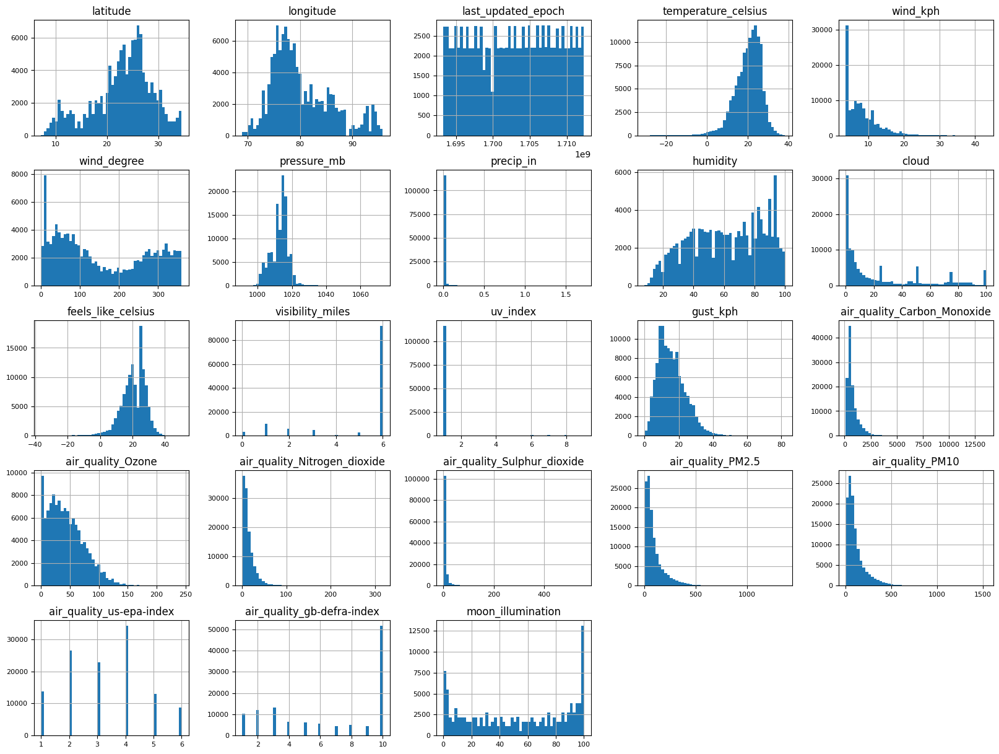

In [9]:
numeric_df.hist(figsize=(20, 15), bins=50, xlabelsize=8, ylabelsize=8);

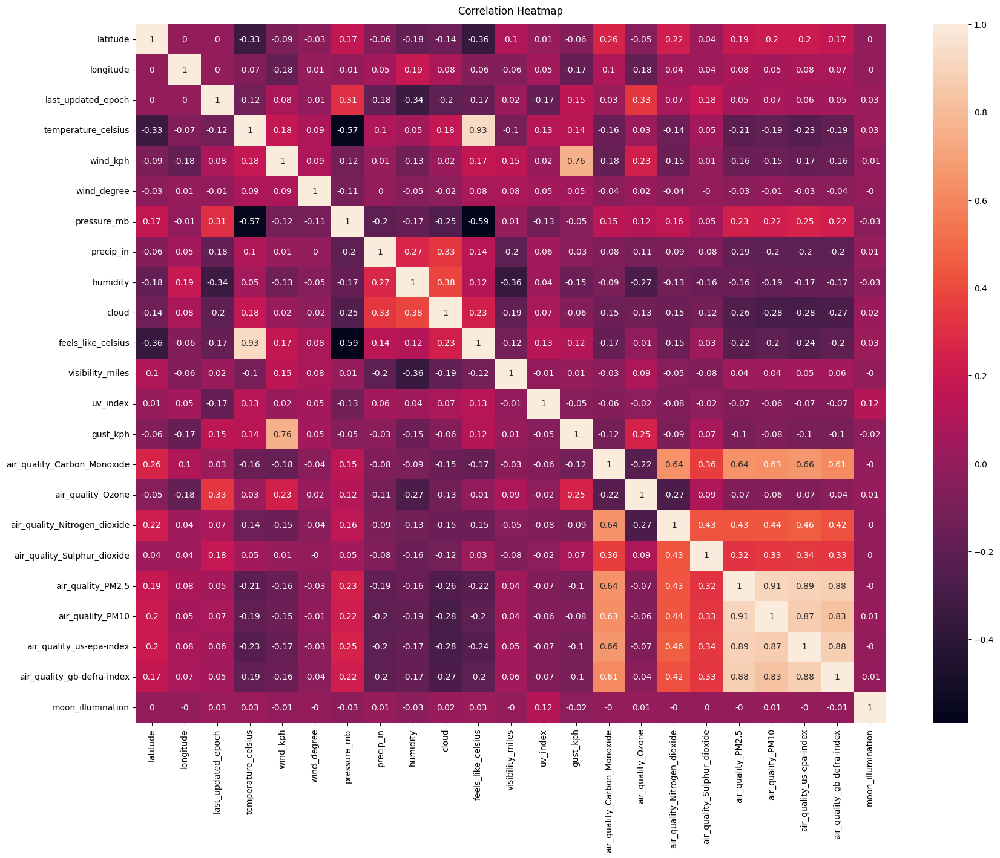

In [10]:
#correration matrix

plt.figure(figsize=(20, 15))
correlation_matrix = numeric_df.corr(method="kendall").round(2)

heatmap=sns.heatmap(data=correlation_matrix, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

In [11]:
#fields with max correlation

correlation_matrix = numeric_df.corr(method="kendall").round(2)
correlation_matrix_abs = correlation_matrix.abs()
max_corr = correlation_matrix_abs[correlation_matrix_abs != 1.0].max().max()
max_corr

0.93

In [12]:
#state wise weather data

fig1=px.bar(dataset.groupby('region')['air_quality_PM2.5'].mean().reset_index(),
           x='region', y='air_quality_PM2.5', 
           title='Average PM2.5 by State')

fig1.update_yaxes(dtick=50) 

fig1.show()

In [13]:
fig1=px.bar(dataset.groupby('region')['temperature_celsius'].mean().reset_index(),
           x='region', y='temperature_celsius', 
           title='Average temp by State')

# fig1.update_yaxes(dtick=50) 

fig1.show()

In [14]:
fig1=px.bar(dataset.groupby('region')['precip_in'].mean().reset_index(),
           x='region', y='precip_in', 
           title='Average precipation by State')

fig1.update_yaxes(dtick=50) 

fig1.show()

In [15]:
#correlation between precipitation and temperature

fig1=px.scatter(dataset, x='temperature_celsius', y='precip_in',color="region", trendline='ols', title='Correlation between temperature and precipitation')

fig1.show()

In [16]:
#correlation between precipitation and pressure_mb

fig1=px.scatter(dataset, x='pressure_mb', y='precip_in',color="region", trendline='ols', title='Correlation between pressure and precipitation')

fig1.show()

In [17]:
#correlation between precipitation and humidity

fig1=px.scatter(dataset, x='humidity', y='precip_in',color="region", trendline='ols', title='Correlation between humidity and precipitation')

fig1.show()

Text(0.5, 1.0, 'Sulphur dioxide vs Precipitation')

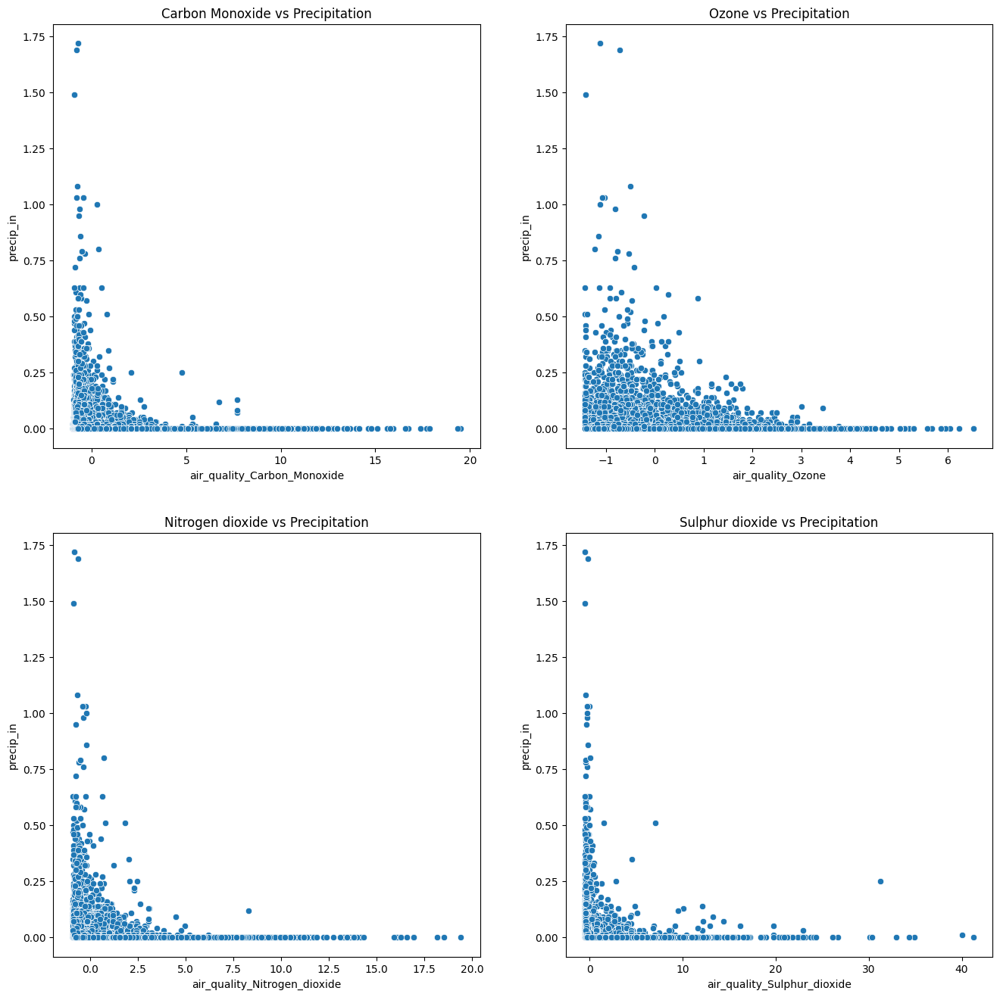

In [18]:
#plotting precipitation and various air quality parameters(scaled)

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

air_quality_metrics = ['air_quality_Carbon_Monoxide', 'air_quality_Ozone', 'air_quality_Nitrogen_dioxide', 
                       'air_quality_Sulphur_dioxide']

dataset_scaled = dataset.copy()
dataset_scaled[air_quality_metrics] = scaler.fit_transform(dataset_scaled[air_quality_metrics])

plt.figure(figsize=(16, 16))
plt.subplot(2, 2, 1)
sns.scatterplot(data=dataset_scaled, x='air_quality_Carbon_Monoxide', y='precip_in')
plt.title('Carbon Monoxide vs Precipitation')

plt.subplot(2, 2, 2)
sns.scatterplot(data=dataset_scaled, x='air_quality_Ozone', y='precip_in')
plt.title('Ozone vs Precipitation')

plt.subplot(2, 2, 3)
sns.scatterplot(data=dataset_scaled, x='air_quality_Nitrogen_dioxide', y='precip_in')
plt.title('Nitrogen dioxide vs Precipitation')

plt.subplot(2, 2, 4)
sns.scatterplot(data=dataset_scaled, x='air_quality_Sulphur_dioxide', y='precip_in')
plt.title('Sulphur dioxide vs Precipitation')

In [19]:
#using ml to predict precipitation

precipation_data=dataset.precip_in
precipation_facters=dataset[['latitude','longitude','wind_kph','wind_degree','pressure_mb','temperature_celsius','humidity','cloud','air_quality_Carbon_Monoxide', 'air_quality_Ozone', 'air_quality_Nitrogen_dioxide', 
                       'air_quality_Sulphur_dioxide']]

In [20]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(precipation_facters, precipation_data, test_size=0.2,random_state=0)

In [21]:
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()

regressor.fit(X_train, y_train)

In [22]:
regressor.score(X_test, y_test)

In [23]:
from sklearn.ensemble import RandomForestRegressor

regressor = RandomForestRegressor(n_estimators=100, random_state=0)
regressor.fit(X_train, y_train)

In [24]:
regressor.score(X_test, y_test)

In [25]:
#predicting temperature

temperature_data=dataset.temperature_celsius
temperature_facters=dataset[['latitude','longitude','wind_kph','wind_degree','pressure_mb','humidity','cloud']]

In [26]:
X_train_temp, X_test_temp, y_train_temp, y_test_temp = train_test_split(temperature_facters, temperature_data, test_size=0.2,random_state=0)

In [27]:
model_temp=RandomForestRegressor(n_estimators=100, random_state=0)
model_temp.fit(X_train_temp, y_train_temp)

In [28]:
model_temp.score(X_test_temp, y_test_temp)

In [29]:
#predicting pressure

pressure_data=dataset.pressure_mb
pressure_facters=dataset[['latitude','longitude','wind_kph','wind_degree','temperature_celsius','humidity','cloud']]

X_train_pressure, X_test_pressure, y_train_pressure, y_test_pressure = train_test_split(pressure_facters, pressure_data, test_size=0.2,random_state=0)

In [30]:
model_pressure=RandomForestRegressor(n_estimators=100, random_state=0)
model_pressure.fit(X_train_pressure, y_train_pressure)

In [31]:
model_pressure.score(X_test_pressure, y_test_pressure)

In [32]:
#predicting humidity

humidity_data=dataset.humidity
humidity_facters=dataset[['latitude','longitude','wind_kph','wind_degree','temperature_celsius','pressure_mb','cloud']]

X_train_humidity, X_test_humidity, y_train_humidity, y_test_humidity = train_test_split(humidity_facters, humidity_data, test_size=0.2,random_state=0)

In [33]:
model_humidity=RandomForestRegressor(n_estimators=100, random_state=0)

model_humidity.fit(X_train_humidity, y_train_humidity)

In [34]:
model_humidity.score(X_test_humidity, y_test_humidity)

In [35]:
len(dataset.condition_text.unique())

50

In [36]:
#plotting the weather conditions vs temperature

fig1=px.bar(dataset.groupby('condition_text')['temperature_celsius'].mean().reset_index(),
              x='condition_text', y='temperature_celsius', 
              title='Average temp by weather condition')

fig1.show()

In [37]:
numeric_df.columns

Index(['latitude', 'longitude', 'last_updated_epoch', 'temperature_celsius',
       'wind_kph', 'wind_degree', 'pressure_mb', 'precip_in', 'humidity',
       'cloud', 'feels_like_celsius', 'visibility_miles', 'uv_index',
       'gust_kph', 'air_quality_Carbon_Monoxide', 'air_quality_Ozone',
       'air_quality_Nitrogen_dioxide', 'air_quality_Sulphur_dioxide',
       'air_quality_PM2.5', 'air_quality_PM10', 'air_quality_us-epa-index',
       'air_quality_gb-defra-index', 'moon_illumination'],
      dtype='object')

In [38]:
#predicting condition
from sklearn.preprocessing import LabelEncoder

# condition_data=dataset.condition_text
encoder=LabelEncoder()
condition_data=encoder.fit_transform(dataset.condition_text)

condition_facters=dataset[['latitude','longitude','wind_kph','wind_degree','pressure_mb','temperature_celsius','humidity','cloud','air_quality_Carbon_Monoxide', 'air_quality_Ozone', 'air_quality_Nitrogen_dioxide']]

X_train_condition, X_test_condition, y_train_condition, y_test_condition = train_test_split(condition_facters, condition_data, test_size=0.2,random_state=0)

In [39]:
model_4=RandomForestRegressor(n_estimators=100, random_state=0)
model_4.fit(X_train_condition, y_train_condition)

NameError: name 'RandomForestRegressor' is not defined

In [ ]:
model_4.score(X_test_condition, y_test_condition)

0.8663900836504144

In [ ]:
# import pickle

# with open('models/precipitation.pkl', 'wb') as file:
#     pickle.dump(regressor, file)
    
# with open('models/temperature.pkl', 'wb') as file:
#     pickle.dump(model_temp, file)
    

    
# with open('models/humidity.pkl', 'wb') as file:
#     pickle.dump(model_humidity, file)

# with open('models/condition.pkl', 'wb') as file:
#     pickle.dump(model_4, file)

In [ ]:
# # with open('models/pressure.pkl', 'wb') as file:
#     pickle.dump(model_pressure, file)

In [ ]:
# with open('models/condition.pkl','rb') as file:
#     model=pickle.load(file)
    
#     score=model.score(X_test_condition, y_test_condition)
    
#     print(score)

In [ ]:
# sunrise: Local time of sunrise
# sunset: Local time of sunset
# moonrise: Local time of moonrise
# moonset: Local time of moonset
# moon_phase: Current moon phase
# moon_illumination: Moon illumination percentage

#predicting moon phase

moon_phases_count=dataset.moon_phase.value_counts()

moon_pie_chart=px.pie(moon_phases_count, values=moon_phases_count.values, names=moon_phases_count.index, title='Moon Phases Distribution')

moon_pie_chart.show()

In [ ]:
dataset.moon_phase.unique()


array(['Waxing Gibbous', 'Full Moon', 'Waning Gibbous', 'Last Quarter',
       'Waning Crescent', 'New Moon', 'Waxing Crescent', 'First Quarter'],
      dtype=object)

In [ ]:
dataset.moon_illumination.head()

0    93
1    93
2    93
3    93
4    93
Name: moon_illumination, dtype: int64

In [ ]:
plt.figure(figsize=(16, 16))

fig = px.box(dataset, x="moon_phase", y="moon_illumination")  # replace "feature1" with your actual feature column name
fig.show()




<Figure size 1600x1600 with 0 Axes>

In [40]:
# dataset.moonrise.head()
from datetime import datetime

def convert_time(x):
    if x == 'No moonrise' or x == 'No moonset' or x == 'No sunrise' or x == 'No sunset':
        return None  # or another value that makes sense in your context
    else:
        return (datetime.strptime(x, "%I:%M %p").hour * 60) + datetime.strptime(x, "%I:%M %p").minute

dataset['moonrise'] = dataset['moonrise'].apply(convert_time)
dataset['moonset'] = dataset['moonset'].apply(convert_time)
dataset['sunrise'] = dataset['sunrise'].apply(convert_time)
dataset['sunset'] = dataset['sunset'].apply(convert_time)

dataset["moonrise"].head()


0    1062.0
1    1059.0
2    1052.0
3    1056.0
4    1058.0
Name: moonrise, dtype: float64

In [41]:

dataset["moonrise"].fillna(dataset["moonrise"].mean(), inplace=True)
dataset["moonset"].fillna(dataset["moonset"].mean(), inplace=True)
dataset["sunrise"].fillna(dataset["sunrise"].mean(), inplace=True)
dataset["sunset"].fillna(dataset["sunset"].mean(), inplace=True)
dataset.isna().sum()

C:\Users\ariel\AppData\Local\Temp\ipykernel_9828\819693072.py:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



C:\Users\ariel\AppData\Local\Temp\ipykernel_9828\819693072.py:2: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True

country                         0
location_name                   0
region                          0
latitude                        0
longitude                       0
timezone                        0
last_updated_epoch              0
last_updated                    0
temperature_celsius             0
temperature_fahrenheit          0
condition_text                  0
wind_mph                        0
wind_kph                        0
wind_degree                     0
wind_direction                  0
pressure_mb                     0
pressure_in                     0
precip_mm                       0
precip_in                       0
humidity                        0
cloud                           0
feels_like_celsius              0
feels_like_fahrenheit           0
visibility_km                   0
visibility_miles                0
uv_index                        0
gust_mph                        0
gust_kph                        0
air_quality_Carbon_Monoxide     0
air_quality_Oz

In [42]:
moon_phase_data=dataset.moon_phase
encoder=LabelEncoder()

moon_phase_data=encoder.fit_transform(moon_phase_data)


moon_phase_features=dataset[['latitude','longitude','sunrise','sunset','moonrise','moonset','moon_illumination']]
#[359,1121,1062,218,93]

X_train_moon, X_test_moon, y_train_moon, y_test_moon = train_test_split(moon_phase_features, moon_phase_data, test_size=0.2,random_state=0)

In [ ]:
classes = encoder.classes_.tolist()
for i, class_name in enumerate(classes):
    print(f"{i}: {class_name}")

0: First Quarter
1: Full Moon
2: Last Quarter
3: New Moon
4: Waning Crescent
5: Waning Gibbous
6: Waxing Crescent
7: Waxing Gibbous


In [43]:
from sklearn.ensemble import RandomForestRegressor

model_moon=RandomForestRegressor(n_estimators=50, random_state=0)

model_moon.fit(X_train_moon, y_train_moon)

RandomForestRegressor(n_estimators=50, random_state=0)

In [44]:
model_moon.score(X_test_moon, y_test_moon)

0.9976032258980889

In [46]:
moon_phases={
0: "First Quarter",
1: "Full Moon",
2: "Last Quarter",
3: "New Moon",
4: "Waning Crescent",
5: "Waning Gibbous",
6: "Waxing Crescent",
7: "Waxing Gibbous",
}

predicted=model_moon.predict([[24.57, 77.72,359,1121,1062,218,93]])
moon_phases[int(predicted[0])]

c:\Users\ariel\anaconda3\envs\py310\lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



'Waxing Gibbous'

In [47]:
import pickle

with open('api/models/moon_phase.pkl', 'wb') as file:
    pickle.dump(model_moon, file)